<a href="https://colab.research.google.com/github/ibonetc/AI_Deep-Learning/blob/main/ExampleRoboflow_BCCD_YOLOv8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Red YOLO

https://github.com/ultralytics/ultralytics

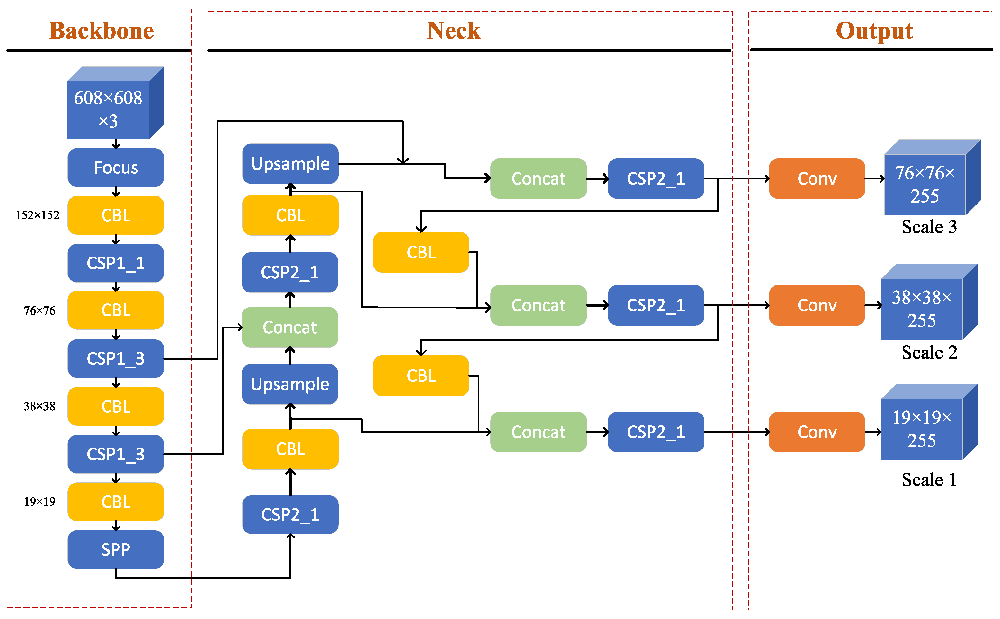

Tomada de: https://www.mdpi.com/2072-4292/13/18/3776/htm

In [ ]:
!nvidia-smi

Thu Aug 31 21:15:09 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   48C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Ejemplo Base de datos BCCD

Si quieres crear tu propia base de datos necesita crear las anotaciones de la misma, o sea identificar las clases dentro de la imagen, para esto puedes usar roboflow: https://docs.roboflow.com/annotate

En este ejemplo vamos a usar la base de datos de ejemplo BCCD: https://public.roboflow.com/object-detection/bccd

En esta base de datos hay 364 imágenes en tres clases: WBC (glóbulos blancos), RBC (glóbulos rojos) y plaquetas. Hay 4888 etiquetas en 3 clases. Son 4155 RBC, 372 WBC y 361 Plaquetas.

Esta base de datos puede ser descargada del *roboflow* directamente usando una API, o puede ser descargada, en este caso para la versión YOLOv5, como haremos en este caso, que la tenemos en Drive.

In [ ]:
!curl -L "https://app.roboflow.com/ds/16C7VJ3F3f?key=Wl9oHHDumY" > BCCD.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2551      0 --:--:-- --:--:-- --:--:--  2552
100 12.5M  100 12.5M    0     0  15.2M      0 --:--:-- --:--:-- --:--:--  286M


In [ ]:
!unzip BCCD.zip -d /content/BCCD/

Archive:  BCCD.zip
 extracting: /content/BCCD/README.roboflow.txt  
 extracting: /content/BCCD/data.yaml  
   creating: /content/BCCD/test/
   creating: /content/BCCD/test/images/
 extracting: /content/BCCD/test/images/BloodImage_00038_jpg.rf.2a543ff80a02042a2a048829778ee05b.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00044_jpg.rf.98d6628627331e35a48310d732bc347d.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00062_jpg.rf.46735e3a30f75df2f0abb8b53b67947c.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00090_jpg.rf.801b4d55017cc7fbfc2132855cccf5d4.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00099_jpg.rf.5b8eca0009cca88b2192c24310e7d48d.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00112_jpg.rf.e6c5a6f018bc9f5fb43c1424f5ce1c90.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00113_jpg.rf.bc50ff85b952c24070d2f5aef2e203ae.jpg  
 extracting: /content/BCCD/test/images/BloodImage_00120_jpg.rf.58ae37ce3bc315a44370d37a34a18a21.jpg  
 ext

In [ ]:
#!unzip /content/drive/MyDrive/Datasets/DatasetsAnalytics/HealthData/BCCD.v3-raw.yolov5pytorch.zip -d /content/BCCD/

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import requests
from io import BytesIO
import cv2
from google.colab.patches import cv2_imshow

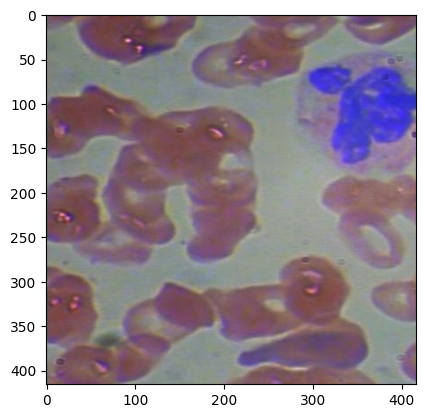

In [ ]:
plt.figure()
img = plt.imread('/content/BCCD/train/images/BloodImage_00001_jpg.rf.5127eaae71c4b12004a977d805672d2a.jpg')
plt.imshow(img)
plt.show()

In [ ]:
img.shape

(416, 416, 3)

In [ ]:
import glob
image_paths=glob.glob('/content/BCCD/train/images/*.jpg')

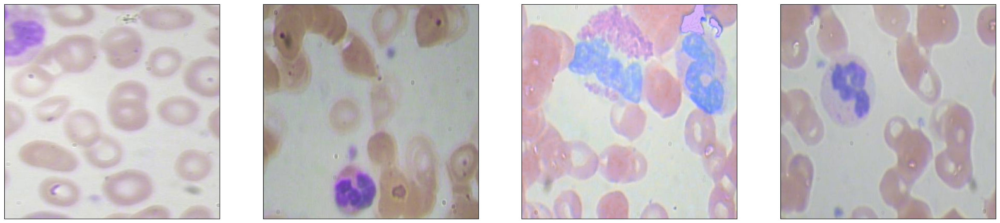

In [ ]:
plt.figure(figsize=(30,60))
for i,imgP in enumerate(image_paths[0:4]):
  ax = plt.subplot(1, 4, i + 1)
  img = plt.imread(imgP)
  plt.imshow(img)
  ax.get_xaxis().set_visible(False)
  ax.get_yaxis().set_visible(False)

In [ ]:
import yaml
with open("/content/BCCD/data.yaml", 'r') as stream:
  num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
num_classes

'3'

Si vemos el fichero data.yaml es el que se genera automáticamenten las direcciones de las imágenes de entrenamiento y validación, así como la cantidad y los nombres de las clases.

Para que las direcciones de entrenamiento y validación estén correctas sin necesidad de cambiar los datos de dirección podemos ponerlas fichas. Copiemos las rutas de las mismas y pongámoslas en el fichero de forma que queden así:

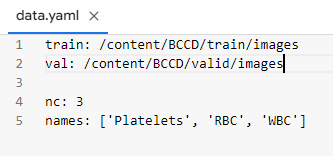



# Instalar YOLOv8


Para esto vamos a seguir los siguientes pasos:
* Instalar dependencias YOLOv5
* Descargar datos personalizados de detección de objetos YOLOv5
* Escribir nuestra configuración de entrenamiento YOLOv5

**NOTA:** Recuerde elegir GPU en Runtime si aún no está seleccionado.

*Entorno de ejecución --> Cambiar tipo de entorno de ejecución --> Acelerador de hardware --> GPU*)

## Instalar dependencias YOLOv8


In [ ]:
!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

In [ ]:
from ultralytics import YOLO
#from IPython.display import display, Image

## Cargar el modelo preentrenado

In [ ]:
model = YOLO("yolov8n.pt")

100%|██████████| 6.23M/6.23M [00:00<00:00, 105MB/s]


YOLO tiene varias tareas:
- Predecir una imagen o video
- Entrenarse utilizando un conjunto de datos
- Validarse en un conjunto de datos
- Track en videos

```
yolo task=detect    mode=train    model=yolov8n.yaml      args...
          classify       predict        yolov8n-cls.yaml  args...
          segment        val            yolov8n-seg.yaml  args...
                         export         yolov8n.pt        format=onnx  args...
```

## PREDECIR Usando YOLO como está entrenada con COCO

La función detect se puede usar con modelos ya entrenados y los resultados se guardan en *runs/detect*



```
python detect.py --source 0  # webcam (utiliza la cámara)
                          img.jpg  # imagen
                          vid.mp4  # video
                          path/  # directorio de imágenes
                          path/*.jpg  # directorio con extención determinada (hace un glob)
                  --save=True guardar las imágenes con los resultados
                  --save_conf=True guardar imágenes con nivel de confianza
                  --save_txt=True guarda las predicciones como etiquetas
                  --save_crop guardar imágenes cortadas con resultados
                  -- conf nivel de confianza en la predicción
                  -- show mostrar resultados
                  -- show_labels mostrar objetos etiquetados
                  -- boxes mostrar rectángulos en las predicciones
                  -- line_width ancho de la línea de los rectángulos
```

Como resultado se obtiene un generador

In [ ]:
results = model.predict("/content/drive/MyDrive/Fotos_Pruebas/habana.jpg")


image 1/1 /content/drive/MyDrive/Fotos_Pruebas/habana.jpg: 480x640 1 person, 5 cars, 1 motorcycle, 63.1ms
Speed: 14.3ms preprocess, 63.1ms inference, 37.7ms postprocess per image at shape (1, 3, 480, 640)


In [ ]:
results

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted p

Diccionario con las clases

In [ ]:
results[0].names

{0: 'person',
 1: 'bicycle',
 2: 'car',
 3: 'motorcycle',
 4: 'airplane',
 5: 'bus',
 6: 'train',
 7: 'truck',
 8: 'boat',
 9: 'traffic light',
 10: 'fire hydrant',
 11: 'stop sign',
 12: 'parking meter',
 13: 'bench',
 14: 'bird',
 15: 'cat',
 16: 'dog',
 17: 'horse',
 18: 'sheep',
 19: 'cow',
 20: 'elephant',
 21: 'bear',
 22: 'zebra',
 23: 'giraffe',
 24: 'backpack',
 25: 'umbrella',
 26: 'handbag',
 27: 'tie',
 28: 'suitcase',
 29: 'frisbee',
 30: 'skis',
 31: 'snowboard',
 32: 'sports ball',
 33: 'kite',
 34: 'baseball bat',
 35: 'baseball glove',
 36: 'skateboard',
 37: 'surfboard',
 38: 'tennis racket',
 39: 'bottle',
 40: 'wine glass',
 41: 'cup',
 42: 'fork',
 43: 'knife',
 44: 'spoon',
 45: 'bowl',
 46: 'banana',
 47: 'apple',
 48: 'sandwich',
 49: 'orange',
 50: 'broccoli',
 51: 'carrot',
 52: 'hot dog',
 53: 'pizza',
 54: 'donut',
 55: 'cake',
 56: 'chair',
 57: 'couch',
 58: 'potted plant',
 59: 'bed',
 60: 'dining table',
 61: 'toilet',
 62: 'tv',
 63: 'laptop',
 64: 'mou

In [ ]:
results[0].boxes

WARNING ⚠️ 'Boxes.boxes' is deprecated. Use 'Boxes.data' instead.


ultralytics.engine.results.Boxes object with attributes:

boxes: tensor([[2.4470e+03, 1.0923e+03, 3.4890e+03, 3.0217e+03, 9.3783e-01, 0.0000e+00],
        [1.5468e+03, 1.3941e+03, 1.8745e+03, 1.5524e+03, 8.0395e-01, 2.0000e+00],
        [2.3500e+03, 1.4013e+03, 2.5985e+03, 1.5275e+03, 7.9478e-01, 2.0000e+00],
        [8.5297e+02, 1.3829e+03, 1.5351e+03, 1.5770e+03, 7.7326e-01, 2.0000e+00],
        [1.9143e+03, 1.3835e+03, 2.3789e+03, 1.5501e+03, 7.2981e-01, 2.0000e+00],
        [3.5273e+03, 1.4022e+03, 3.8295e+03, 1.5089e+03, 7.1425e-01, 2.0000e+00],
        [1.6214e+02, 1.3854e+03, 4.3336e+02, 1.5780e+03, 7.0423e-01, 3.0000e+00]], device='cuda:0')
cls: tensor([0., 2., 2., 2., 2., 2., 3.], device='cuda:0')
conf: tensor([0.9378, 0.8039, 0.7948, 0.7733, 0.7298, 0.7143, 0.7042], device='cuda:0')
data: tensor([[2.4470e+03, 1.0923e+03, 3.4890e+03, 3.0217e+03, 9.3783e-01, 0.0000e+00],
        [1.5468e+03, 1.3941e+03, 1.8745e+03, 1.5524e+03, 8.0395e-01, 2.0000e+00],
        [2.3500e+03, 1.401

### Mostrar resultados

Ver : https://docs.ultralytics.com/modes/predict/#plotting-results para los parámetros de la función plot

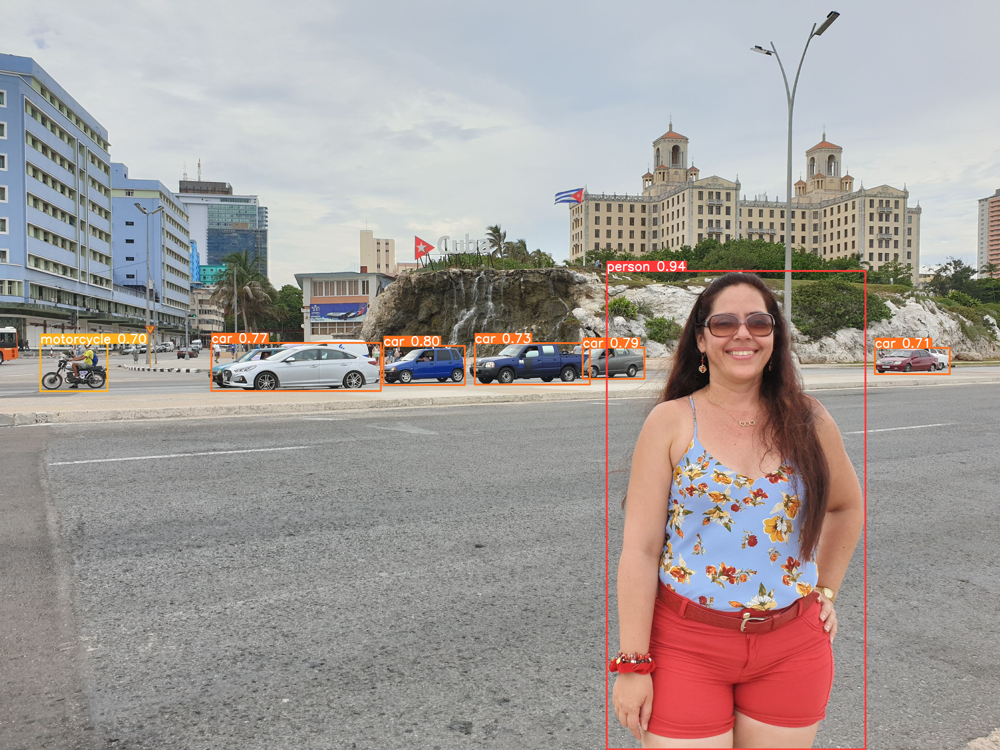

In [ ]:
for r in results:
    im_array = r.plot(line_width=5) # font_size
    im = Image.fromarray(im_array[..., ::-1])  # imagen RGB PIL
    cv2_imshow(im_array)
    im.save('results.jpg')  # guardar image

## Guardando los resultados desde la predicción

In [ ]:
results_2 = model.predict("/content/drive/MyDrive/Fotos_Pruebas/habana.jpg",
                          save=True,show_labels=True, boxes=True, save_crop=True, line_width=5)


image 1/1 /content/drive/MyDrive/Fotos_Pruebas/habana.jpg: 480x640 1 person, 5 cars, 1 motorcycle, 6.5ms
Speed: 3.2ms preprocess, 6.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict


# Entrenar la red YOLO con este ejemplo

Cargar el modelo y pasar los parámetros correspondientes para entrenar con la base de datos

https://docs.ultralytics.com/usage/cfg/#train

In [9]:
model = YOLO('yolov8s.pt')

In [10]:
path='/content/drive/MyDrive/Test_YOLO/'
subpath='BCCD'

In [11]:
results = model.train(data='/content/BCCD/data.yaml', epochs=100, imgsz=416,
                      project=path, # dirección para guardar los resultados
                      name=subpath, # nombre de subdirectorio
                      val=True)

Ultralytics YOLOv8.0.168 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/BCCD/data.yaml, epochs=100, patience=50, batch=16, imgsz=416, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/Test_YOLO/, name=BCCD, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torc

## Evaluar la red

Las pérdidas de entrenamiento y las métricas de rendimiento se guardan en Tensorboard y también en un archivo de registro definido anteriormente con el indicador *--name* cuando entrenamos. En nuestro caso, lo llamamos yolov5s_results. (Si no se le asigna un nombre, el valor predeterminado es *results.txt*). El archivo de resultados se representa como un png una vez que finaliza el entrenamiento.

**Nota de Glenn**: Los archivos *results.txt* parcialmente completados se pueden trazar con *from utils.utils import plot_results; plot_results()*.

In [12]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

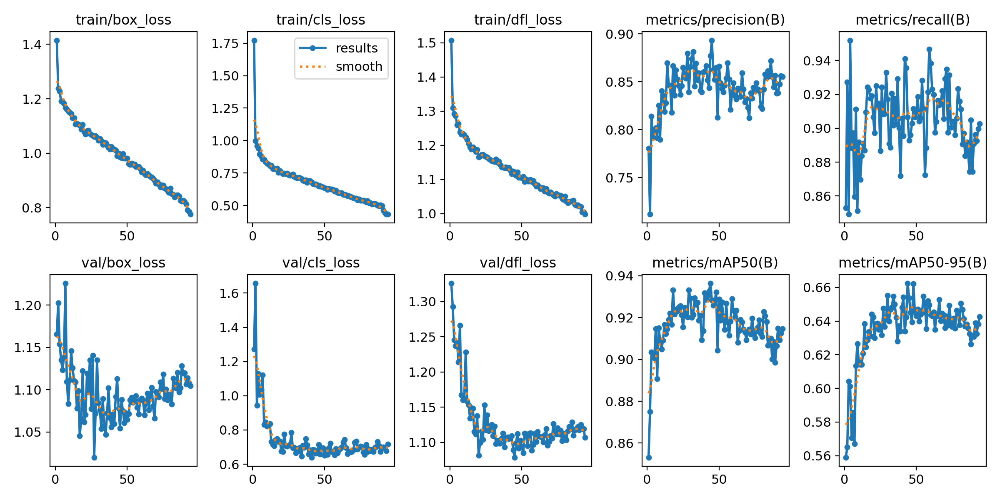

In [13]:
from IPython.display import Image
Image(filename=path+subpath+'/results.png', width=1000)  # results.png

## Visualizar nuestros datos de entrenamiento con etiquetas



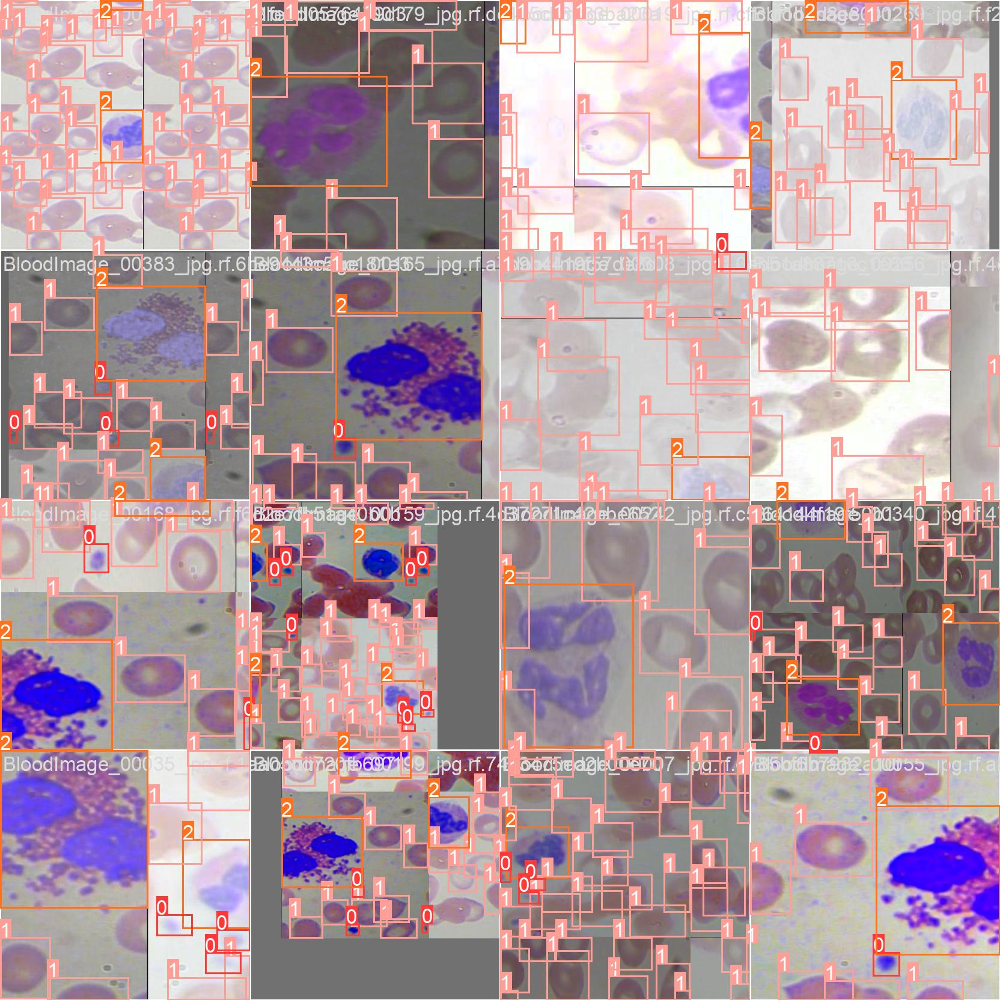

In [14]:
Image(filename=path+subpath+'/train_batch0.jpg', width=1000)

## Validar el modelo

In [ ]:
#model = YOLO('/content/drive/MyDrive/Test_YOLO/BCCD/weights/best.pt')  # load a custom model

In [15]:
metrics = model.val(plots=True)  # no arguments needed, dataset and settings remembered

Ultralytics YOLOv8.0.168 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients
val: Scanning /content/BCCD/valid/labels.cache... 73 images, 0 backgrounds, 0 corrupt: 100%|██████████| 73/73 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:11<00:00,  2.27s/it]
                   all         73        967      0.877       0.91      0.936      0.665
             Platelets         73         76      0.869      0.882      0.927      0.547
                   RBC         73        819      0.792       0.85        0.9      0.642
                   WBC         73         72      0.968          1      0.982      0.805
Speed: 2.2ms preprocess, 18.1ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to /content/drive/MyDrive/Test_YOLO/BCCD2


In [16]:
print(metrics.box.map)    # map50-95
print(metrics.box.map50)  # map50
print(metrics.box.map75)  # map75
print(metrics.box.maps)   # lista map50-95

0.6646255825098549
0.9362969374080098
0.7846188675467589
[     0.5468      0.6416     0.80548]


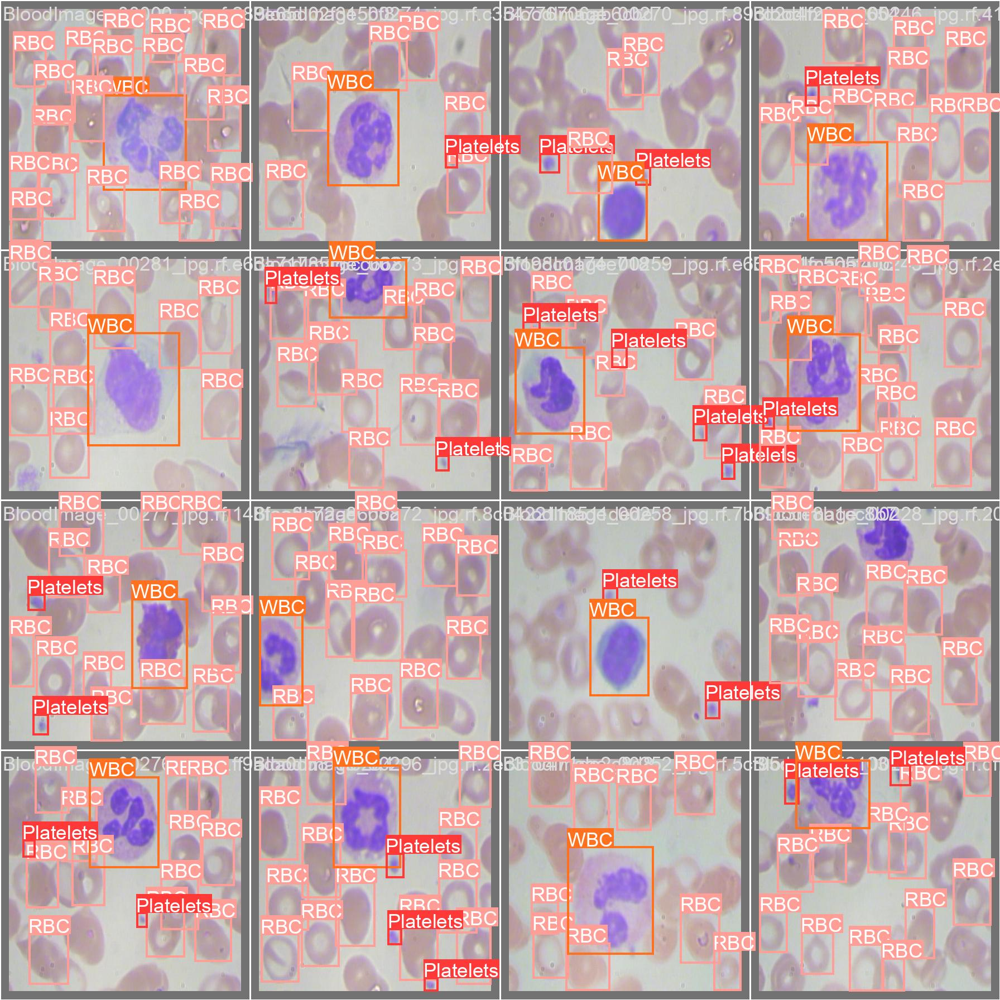

In [ ]:
Image(filename=path+subpath+'2/val_batch0_labels.jpg', width=1000)

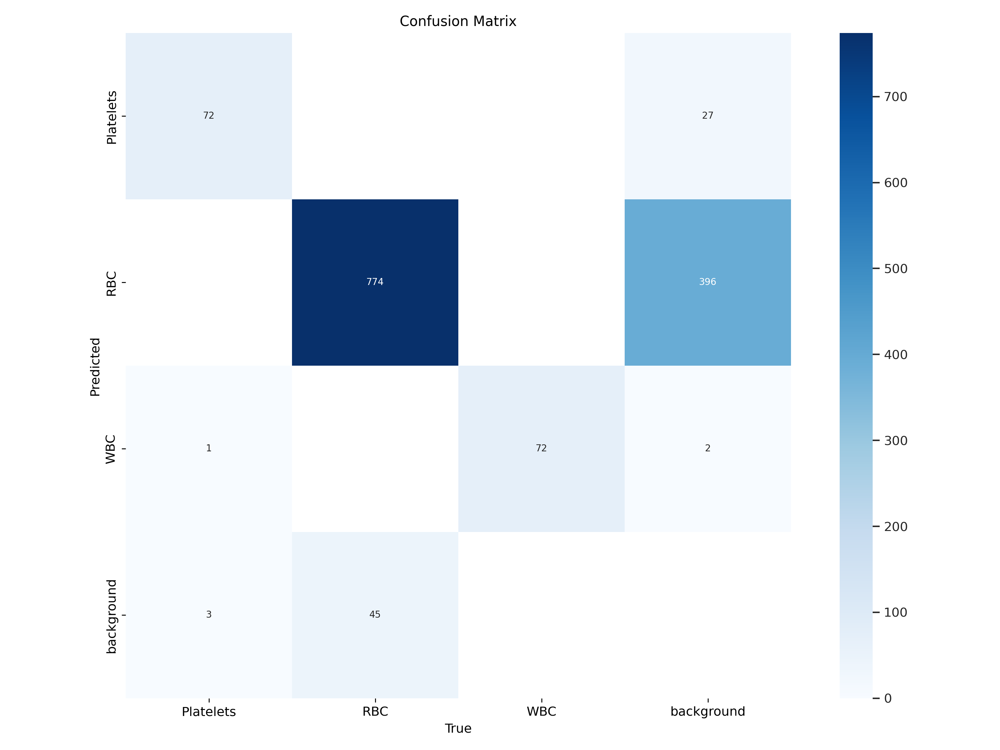

In [ ]:
Image(filename='/content/drive/MyDrive/Test_YOLO/BCCD2/confusion_matrix.png', width=1000)

## Ejecutar inferencia con pesos entrenados
Ejecute la inferencia con un punto de control entrenado previamente en el contenido de la carpeta de prueba/imágenes descargada de Roboflow.

In [ ]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source /content/BCCD/test/images

/content/yolov5
detect: weights=['runs/train/yolov5s_results/weights/best.pt'], source=/content/BCCD/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-356-g4d8d84b Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
custom_YOLOv5s summary: 232 layers, 7251912 parameters, 0 gradients, 16.8 GFLOPs
image 1/36 /content/BCCD/test/images/BloodImage_00038_jpg.rf.63d04b5c9db95f32fa7669f72e4903ca.jpg: 320x416 2 Plateletss, 22 RBCs, 1 WBC, Done. (0.013s)
image 2/36 /content/BCCD/test/images/BloodImage_00044_jpg.rf.589ee3d351cb6d9a3f7b7a942da5370a.jpg: 320x416 2 Plateletss, 18 RBCs, 2 WBCs, Done. (0.009s)
image 3/36 /c

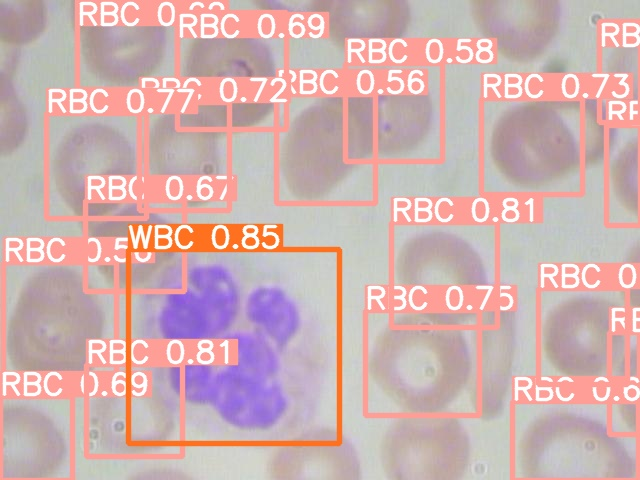

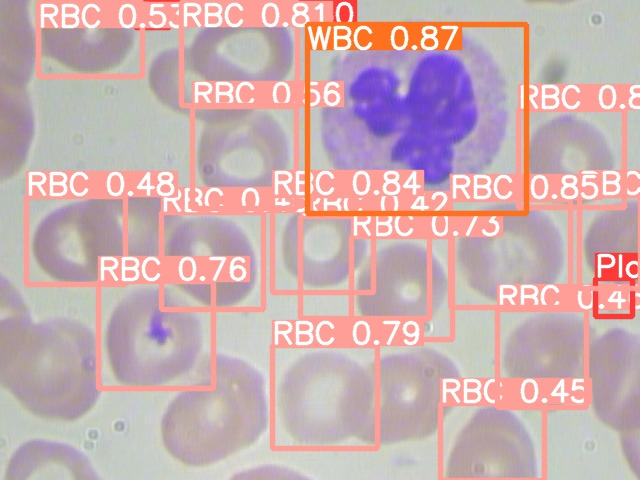

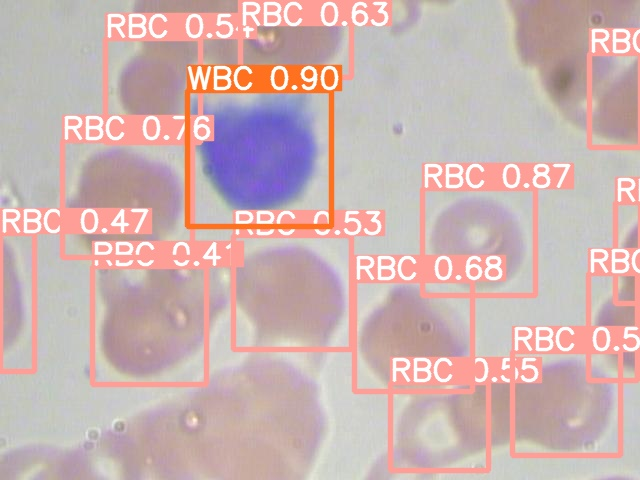

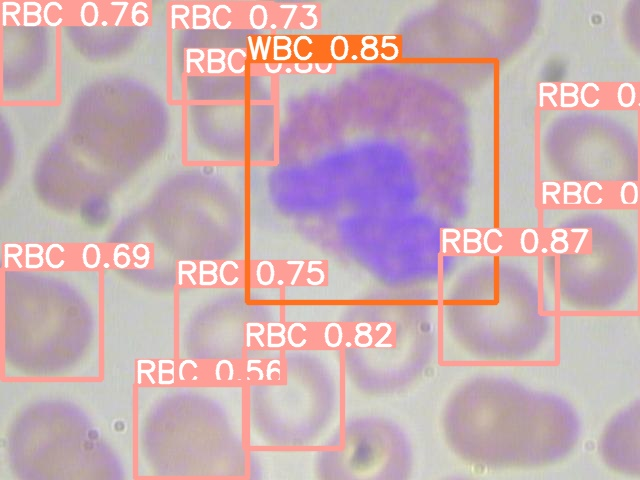

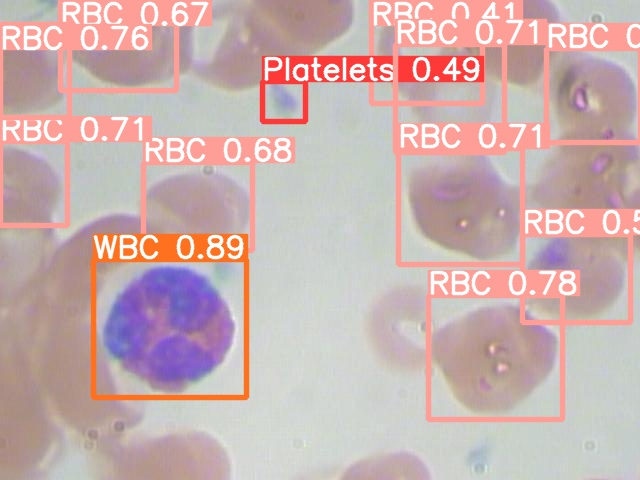

...

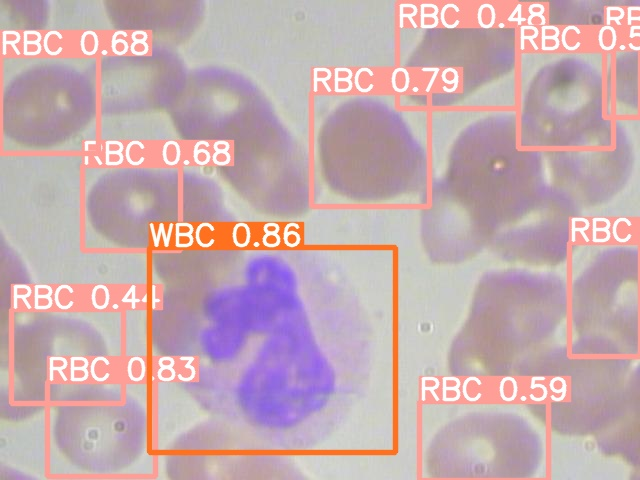

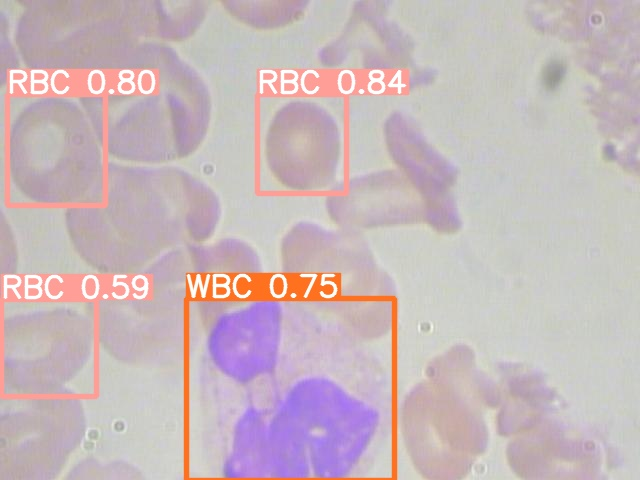

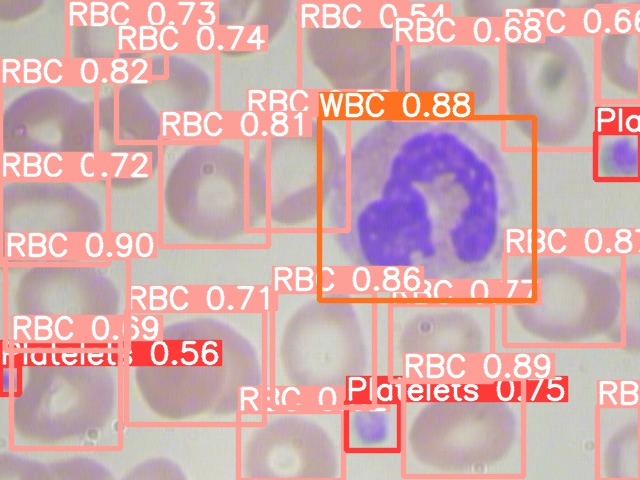

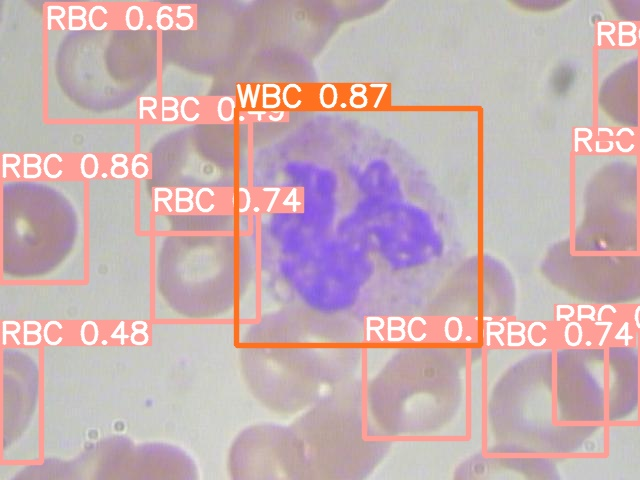

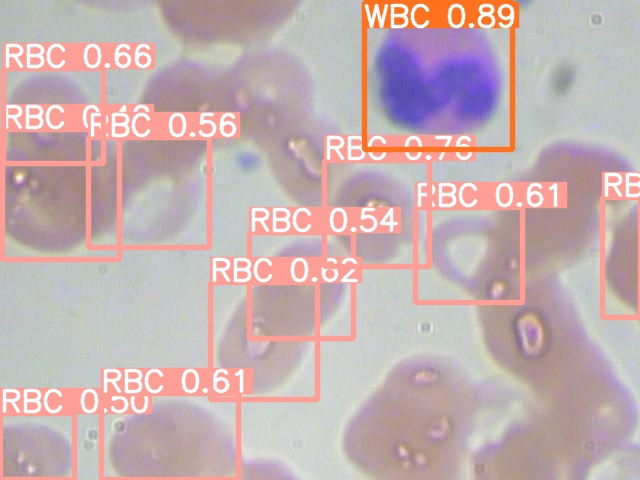

In [ ]:
import glob
from IPython.display import Image, display
for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'):
  display(Image(filename=imageName))
  print("\n")